In [1]:
#IL27
#Import necessary libraries

%pip install dmba


from pathlib import Path

import pandas as pd
import numpy as np
from sklearn.tree import DecisionTreeClassifier, DecisionTreeRegressor
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from sklearn.model_selection import train_test_split, cross_val_score, GridSearchCV
import matplotlib.pylab as plt
import dmba
from dmba import plotDecisionTree, classificationSummary, regressionSummary
from sklearn.metrics import accuracy_score, roc_curve, auc
from dmba import regressionSummary, classificationSummary, liftChart, gainsChart

%matplotlib inline

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 11.8/11.8 MB 15.3 MB/s eta 0:00:00
Colab environment detected.


In [2]:
#IL27
#Enabling path for graphviz.
import os
graph_path = 'C:/Users/Ian/windows_10_msbuild_Release_graphviz-9.0.0-win32/Graphviz/bin'
os.environ["PATH"] += os.pathsep + graph_path

In [5]:
#IL27
#The following code creates a dataframe using the hurricanes7.csv file as the source.


file_path = '/content/hurricanes7.csv'
hurricane_dfIL27 = pd.read_csv(file_path)

#Grouping by name.

grouped_hurricanes = hurricane_dfIL27.groupby('Name')

#Getting averages.

averaged_hurricanes = grouped_hurricanes.mean()

#Dropping columns from base data frame.

hurricane_dfIL27 = hurricane_dfIL27.drop(columns=['ATCF', 'Name', 'RecordNum'])

hurricane_dfIL27.dtypes




<ipython-input-5-8283c5db2b16>:14: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  averaged_hurricanes = grouped_hurricanes.mean()


MaxWind           int64
MinPressure       int64
NextWind          int64
NextWindHigher    int64
Elevation         int64
DeepOcean         int64
Speed             int64
Size34            int64
Size50            int64
Size64            int64
WindInc           int64
PressureInc       int64
Size34Inc         int64
Size50Inc         int64
Size64Inc         int64
ElevationInc      int64
SpeedInc          int64
dtype: object

In [10]:
#IL27
#The tree is "branched out" to display all nodes.

classTreeIL27 = DecisionTreeClassifier(random_state=0)
classTreeIL27.fit(hurricane_dfIL27.drop(columns=['NextWindHigher', 'NextWind']), hurricane_dfIL27['NextWindHigher'])

plotDecisionTree(classTreeIL27, feature_names=hurricane_dfIL27.columns[:15], class_names=classTreeIL27.classes_)

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.836213 to fit


In [12]:
#IL27
#A model is trained for the tree.

X = hurricane_dfIL27.drop(columns=['NextWindHigher', 'NextWind'])
y = hurricane_dfIL27['NextWindHigher']
train_X, valid_X, train_y, valid_y = train_test_split(X, y, train_size=0.6, test_size=0.4, random_state=7)

fullClassTreeIL27 = DecisionTreeClassifier()
fullClassTreeIL27.fit(train_X, train_y)

plotDecisionTree(fullClassTreeIL27, feature_names=train_X.columns)

In [14]:
#IL27
#A classification summary (confusion matrix) is produced for the model tree
# against the validation set.

classificationSummary(valid_y, fullClassTreeIL27.predict(valid_X))

#Based on the overfitting of the model, it'll need to be accounted for with
#grid search to construct a better tree.

Confusion Matrix (Accuracy 0.7134)

       Prediction
Actual    0    1
     0 1865  431
     1  455  340


In [15]:
#IL27

#Five-fold cross-validation of the full decision tree classifier
treeClassifier = DecisionTreeClassifier()

scoresIL27 = cross_val_score(treeClassifier, train_X, train_y, cv=5)
print('Accuracy scores of each fold: ', [f'{acc:.3f}' for acc in scoresIL27])
print(f'Accuracy: {scoresIL27.mean():.3f} (+/- {scoresIL27.std() * 2:.3f})')
print(f'Accuracy: {scoresIL27.mean():.3f} (+/- {scoresIL27.std():.3f})')

Accuracy scores of each fold:  ['0.693', '0.714', '0.704', '0.723', '0.728']
Accuracy: 0.712 (+/- 0.026)
Accuracy: 0.712 (+/- 0.013)


In [18]:
#IL27
#Start with an initial guess for parameters.

param_grid = {
    'max_depth': [10, 20, 30, 40],
    'min_samples_split': [20, 40, 60, 80, 100],
    'min_impurity_decrease': [0, 0.0005, 0.001, 0.005, 0.01],
}
gridSearchIL27 = GridSearchCV(DecisionTreeClassifier(), param_grid, scoring='roc_auc', cv=5, n_jobs=-1)
gridSearchIL27.fit(train_X, train_y)
print('Initial score: ', gridSearchIL27.best_score_)
print('Initial parameters: ', gridSearchIL27.best_params_)

#Adapt grid based on result from initial grid search
param_grid = {
    'max_depth': list(range(3, 20)),
    'min_samples_split': list(range(100, 110)),
    'min_impurity_decrease': [0.0007, 0.001, 0.0121],
}
gridSearchIL27 = GridSearchCV(DecisionTreeClassifier(), param_grid, scoring='roc_auc', cv=5, n_jobs=-1)
gridSearchIL27.fit(train_X, train_y)
print('Improved score: ', gridSearchIL27.best_score_)
print('Improved parameters: ', gridSearchIL27.best_params_)

bestClassTreeIL27 = gridSearchIL27.best_estimator_

Initial score:  0.7953560389228826
Initial parameters:  {'max_depth': 10, 'min_impurity_decrease': 0.001, 'min_samples_split': 100}
Improved score:  0.7967697376032559
Improved parameters:  {'max_depth': 5, 'min_impurity_decrease': 0.001, 'min_samples_split': 108}


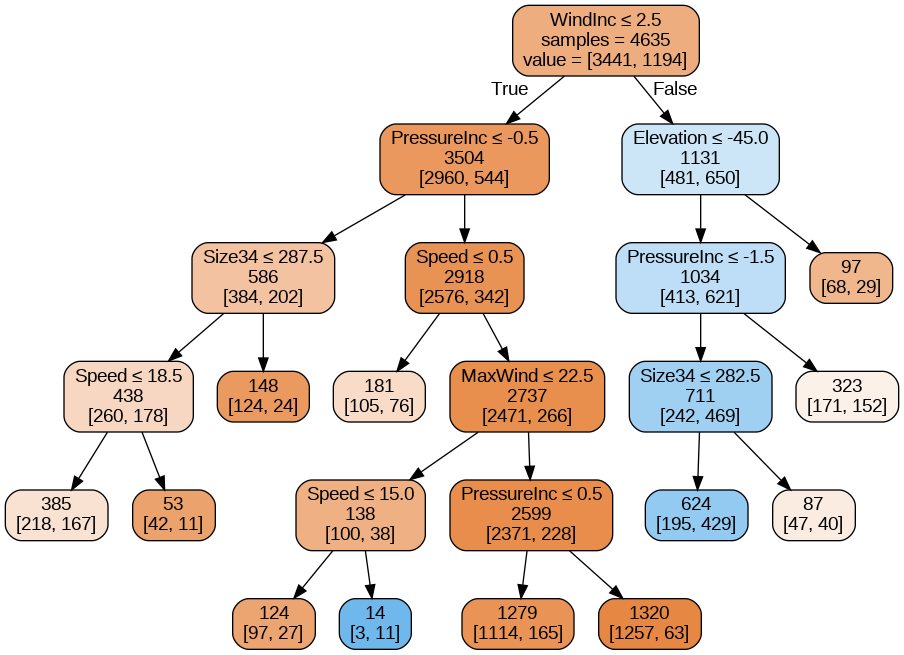

In [19]:
#IL27
#Plot the best class tree.
plotDecisionTree(bestClassTreeIL27, feature_names=train_X.columns)

In [20]:
#IL27
#A classification summary (confusion matrix) is produced for the model tree
# against validation sets.

classificationSummary(valid_y, bestClassTreeIL27.predict(valid_X))

Confusion Matrix (Accuracy 0.7813)

       Prediction
Actual    0    1
     0 2140  156
     1  520  275


In [21]:
#IL27
#A random forest classifier was constructed using 750 estimators.

rfIL27 = RandomForestClassifier(n_estimators=1500)
rfIL27.fit(train_X, train_y)

RandomForestClassifier(n_estimators=1500)

In [22]:
#IL27
#Scoring the random forest model.

classificationSummary(valid_y, rfIL27.predict(valid_X))

Confusion Matrix (Accuracy 0.7752)

       Prediction
Actual    0    1
     0 2046  250
     1  445  350


In [23]:
#IL27
#Establishing variable importance.

importancesIL27 = rfIL27.feature_importances_
stdIL27 = np.std([tree.feature_importances_ for tree in rfIL27.estimators_], axis=0)

variableImport_IL27 = pd.DataFrame({'feature': train_X.columns, 'importance': importancesIL27, 'std': stdIL27})

variableImport_IL27 = variableImport_IL27.sort_values(ascending=False, by='importance')
print(variableImport_IL27)

         feature  importance       std
2      Elevation    0.143363  0.013791
9    PressureInc    0.127140  0.053914
13  ElevationInc    0.112571  0.012400
8        WindInc    0.100458  0.060070
1    MinPressure    0.094771  0.010598
4          Speed    0.090954  0.011314
5         Size34    0.069668  0.011882
14      SpeedInc    0.066447  0.008348
0        MaxWind    0.055618  0.008620
10     Size34Inc    0.046559  0.012611
6         Size50    0.031175  0.009165
11     Size50Inc    0.023661  0.009992
7         Size64    0.015921  0.006215
12     Size64Inc    0.013344  0.008291
3      DeepOcean    0.008351  0.004972


In [25]:
#IL27
#Constructing a boosted tree classifier.

boostIL27 = GradientBoostingClassifier()
boostIL27.fit(train_X, train_y)

#Evaluating accuracy of the boosted tree.

classificationSummary(valid_y, boostIL27.predict(valid_X))

Confusion Matrix (Accuracy 0.7810)

       Prediction
Actual    0    1
     0 2085  211
     1  466  329


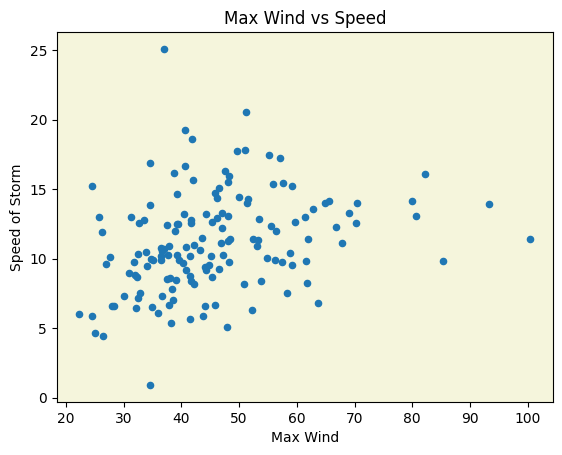

In [26]:
#IL27
#Construction of a scatter plot comparing Max Wind to Speed averages for each hurricane.

ax = averaged_hurricanes.plot.scatter(x='MaxWind', y='Speed', title = 'Max Wind vs Speed', legend=False)

ax.set_facecolor("beige")
ax.set_xlabel('Max Wind')
ax.set_ylabel('Speed of Storm')
plt.show()

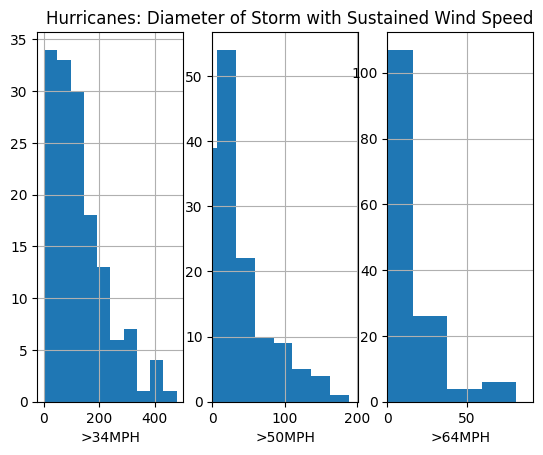

In [27]:
#IL27
#Construction of boxplots, side by side.
fig, axes = plt.subplots(nrows=1, ncols=3)

averaged_hurricanes.Size34.hist(ax=axes[0])
averaged_hurricanes.Size50.hist(ax=axes[1])
averaged_hurricanes.Size64.hist(ax=axes[2])
plt.title('Hurricanes: Diameter of Storm with Sustained Wind Speed', loc='right')

axes[1].set_xlim(0,)
axes[2].set_xlim(0,)

axes[0].set_xlabel('>34MPH')
axes[1].set_xlabel('>50MPH')
axes[2].set_xlabel('>64MPH')

ax.set_ylabel('Count')

plt.show()

In [28]:
#IL27
#The number of "leaves" is tallied on the tree by using the estimatorIL27
#variable in conjunction with parsing the number of child nodes.

estimatorIL27 = bestClassTreeIL27

# Using those arrays, we can parse the tree structure:

n_nodes = estimatorIL27.tree_.node_count
children_left = estimatorIL27.tree_.children_left
children_right = estimatorIL27.tree_.children_right
feature = estimatorIL27.tree_.feature
threshold = estimatorIL27.tree_.threshold
value = estimatorIL27.tree_.value


#The tree structure can be traversed to compute various properties such
#as the depth of each node and whether or not it is a leaf.
node_depth = np.zeros(shape=n_nodes, dtype=np.int64)
is_leaves = np.zeros(shape=n_nodes, dtype=bool)
stack = [(0, -1)]  #Seed is the root node id and its parent depth
while len(stack) > 0:
    node_id, parent_depth = stack.pop()
    node_depth[node_id] = parent_depth + 1

    # If we have a test node
    if (children_left[node_id] != children_right[node_id]):
        stack.append((children_left[node_id], parent_depth + 1))
        stack.append((children_right[node_id], parent_depth + 1))
    else:
        is_leaves[node_id] = True

from collections import Counter
nodeClassCounter = Counter()
terminal_leaves = 0
for i in range(n_nodes):
    if is_leaves[i]:
        terminal_leaves = terminal_leaves + 1
        nodeClassCounter.update([np.argmax(value[i][0])])
print()
print('Number of terminal leaves', terminal_leaves)
print(nodeClassCounter)

estimator2IL27 = classTreeIL27

#Tree structure for the full class tree for comparison

n_nodes = estimator2IL27.tree_.node_count
children_left = estimator2IL27.tree_.children_left
children_right = estimator2IL27.tree_.children_right
feature = estimator2IL27.tree_.feature
threshold = estimator2IL27.tree_.threshold
value = estimator2IL27.tree_.value


#The tree structure can be traversed to compute various properties such
#as the depth of each node and whether or not it is a leaf.
node_depth = np.zeros(shape=n_nodes, dtype=np.int64)
is_leaves = np.zeros(shape=n_nodes, dtype=bool)
stack = [(0, -1)]  #Seed is the root node id and its parent depth
while len(stack) > 0:
    node_id, parent_depth = stack.pop()
    node_depth[node_id] = parent_depth + 1

    # If we have a test node
    if (children_left[node_id] != children_right[node_id]):
        stack.append((children_left[node_id], parent_depth + 1))
        stack.append((children_right[node_id], parent_depth + 1))
    else:
        is_leaves[node_id] = True

from collections import Counter
nodeClassCounter = Counter()
terminal_leaves = 0
for i in range(n_nodes):
    if is_leaves[i]:
        terminal_leaves = terminal_leaves + 1
        nodeClassCounter.update([np.argmax(value[i][0])])
print()
print('Number of terminal leaves', terminal_leaves)
print(nodeClassCounter)




Number of terminal leaves 12
Counter({0: 10, 1: 2})

Number of terminal leaves 1395
Counter({0: 708, 1: 687})
